In [ ]:
cd "./drive/MyDrive"

/content/drive/MyDrive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
mkdir "CDAC"

In [ ]:
cd "./drive/MyDrive/CDAC/"

/content/drive/MyDrive/CDAC


### **Robotics**

In [ ]:
# End Effector Orientation
import numpy as np

theta3, theta4 = 0, 0
alpha3, alpha4 = (np.pi/2), 0
r3, r4 = 0, 0
d3, d4 = 0, 10.2

H3_4 = [
    [np.cos(theta3+(np.pi/2)), (-np.sin(theta3+(np.pi/2)))*(np.cos(alpha3)), (np.sin(theta3+(np.pi/2))*np.sin(alpha3)), r3*np.cos(theta3+(np.pi/2))],
    [np.sin(theta3+(np.pi/2)), (np.cos(theta3+(np.pi/2))*np.cos(alpha3)), (-np.cos(theta3+(np.pi/2))*np.sin(alpha3)), r3*np.sin(theta3+(np.pi/2))],
    [0, np.sin(alpha3), np.cos(alpha3), d3],
    [0, 0, 0, 1]
]

H4_5 = [
    [np.cos(theta4), (-np.sin(theta4))*(np.cos(alpha4)), (np.sin(theta4)*np.sin(alpha4)), r4*np.cos(theta4)],
    [np.sin(theta4), (np.cos(theta4)*np.cos(alpha4)), (-np.cos(theta4)*np.sin(alpha4)), r4*np.sin(theta4)],
    [0, np.sin(alpha4), np.cos(alpha4), d4],
    [0, 0, 0, 1]
]
print(np.matrix(H3_4))
print(np.matrix(H4_5))

[[ 6.12323400e-17 -6.12323400e-17  1.00000000e+00  0.00000000e+00]
 [ 1.00000000e+00  3.74939946e-33 -6.12323400e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  6.12323400e-17  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[ 1.  -0.   0.   0. ]
 [ 0.   1.  -0.   0. ]
 [ 0.   0.   1.  10.2]
 [ 0.   0.   0.   1. ]]


In [ ]:
# Forward Kinematics
import numpy as np

repeat = True

while repeat:
    theta1, theta2, theta3, theta4, theta5 = input().split()

    theta1, theta2, theta3, theta4, theta5 = float(theta1), float(theta2), float(theta3), float(theta4), float(theta5)

    #link1, link2, link3, link4, link5 = 244, 344, 200, 126, 96.655
    link1, link2, link3, link4, link5 = 180, 250, 120, 38.812, 10.188

    H0_3 = [
        [np.cos(theta1)*np.cos(theta2+theta3), -(np.cos(theta1)*np.sin(theta2+theta3)), -np.sin(theta1), np.cos(theta1)*(link2*np.cos(theta2) + link3*np.cos(theta2+theta3))],
        [np.sin(theta1)*np.cos(theta2+theta3), -(np.sin(theta1)*np.sin(theta2+theta3)), np.cos(theta1), np.sin(theta1)*(link2*np.cos(theta2) + link3*np.cos(theta2+theta3))],
        [-np.sin(theta2+theta3), -np.cos(theta2+theta3), 0, (link1 - link2*np.sin(theta2) - link3*np.sin(theta2+theta3))],
        [0, 0, 0, 1]
    ]
    
    R0_3 = [
            [np.cos(theta1)*np.cos(theta2+theta3), (-np.cos(theta1))*np.sin(theta2+theta3), -np.sin(theta1)],
            [np.sin(theta1)*np.cos(theta2+theta3), (-np.sin(theta1))*np.sin(theta2+theta3), np.cos(theta1)],
            [-np.sin(theta2+theta3), -np.cos(theta2+theta3), 0]
    ]
    
    print(np.matrix(H0_3))

    H3_5 = [
        [np.cos(theta4)*np.cos(theta5), -(np.cos(theta4)*np.sin(theta5)), -np.sin(theta4), -(link5*np.sin(theta4))],
        [np.sin(theta4)*np.cos(theta5), -(np.sin(theta4)*np.sin(theta5)), np.cos(theta4), (link5*np.cos(theta4))],
        [-np.sin(theta5), -np.cos(theta5), 0, 0],
        [0, 0, 0, 1]
    ]

    R3_5 = [
            [np.cos(theta4)*np.cos(theta5), (-np.cos(theta4))*np.sin(theta5), np.sin(theta4)],
            [np.sin(theta4)*np.cos(theta5), (-np.sin(theta4))*np.sin(theta5), np.cos(theta4)],
            [-np.sin(theta5), -np.cos(theta5), 0]
    ]

    print(np.matrix(H3_5))

    asked_0 = input("Continue ?  [y/n] \n")

    if asked_0 == "y":
      repeat = True
    else:
      repeat = False

90 90 90 90 90
[[   0.26815417   -0.35897536   -0.89399666   82.37099144]
 [  -0.53502131    0.71622778   -0.44807362 -164.34663607]
 [   0.80115264    0.59846007    0.           52.63915039]
 [   0.            0.            0.            1.        ]]
[[ 0.20076997  0.40057632 -0.89399666 -9.10803801]
 [-0.40057632 -0.79923003 -0.44807362 -4.564974  ]
 [-0.89399666  0.44807362  0.          0.        ]
 [ 0.          0.          0.          1.        ]]
Continue ?  y/n 
y
0 0 0 0 0
[[  1.  -0.  -0. 370.]
 [  0.  -0.   1.   0.]
 [ -0.  -1.   0. 180.]
 [  0.   0.   0.   1.]]
[[ 1.    -0.    -0.    -0.   ]
 [ 0.    -0.     1.    10.188]
 [-0.    -1.     0.     0.   ]
 [ 0.     0.     0.     1.   ]]
Continue ?  y/n 
y
90 90 80 5 4
[[ -0.4202907    0.15532448  -0.89399666  -0.24239269]
 [  0.83856418  -0.30990346  -0.44807362   0.483622  ]
 [ -0.34664946  -0.93799475   0.         -85.09710056]
 [  0.           0.           0.           1.        ]]
[[-0.18541398  0.21467625  0.95892427  9.76

In [ ]:
# Inverse Kinematics
import numpy as np
import math

repeat = True

while repeat:
    X, Y, Z = input().split()
    
    X, Y, Z = float(X), float(Y), float(Z)
    
    #a1, a2, a3, a4, a5 = 244.00, 344.00, 200.00, 126.00, 96.655
    a1, a2, a3, a4, a5 = 180.00, 250.00, 120.00, 38.812, 10.188
    
    r1 = math.sqrt(((X**2)+(Y**2)))
    r2 = Z - a1
    r3 = math.sqrt((r1**2)+(r2**2))
    
    try:
        print("Values of r1, r2, r3:",r1,r2,r3)
        
        value1 = r2/r1
        phi1 = np.arctan(value1)
        cosphi1 = (a2**2+r3**2-a3**2)/(2*a2*r3)
        sinphi1 = math.sqrt(1-(cosphi1**2))
        phi2 = np.arctan2(sinphi1, cosphi1)
        cosphi3 = (a2**2+a3**2-r3**2)/(2*a2*a3)
        sinphi3 = math.sqrt(1-(cosphi3**2))
        phi3 = np.arctan2(sinphi3, cosphi3)
        
        print("Values of value1, sinphi1, cosphi1, sinphi3, cosphi3:",value1, sinphi1, cosphi1, sinphi3, cosphi3)
        print("Values of phi1, phi2, phi3:",phi1,phi2,phi3)
        
        theta1 = np.arctan2(Y,X)
        theta2 = phi1 + phi2
        theta3 = -(np.pi - phi3)
        
        print("Values of theta1, theta2, theta3, theta4, theta5 (Radian):",theta1, theta2, theta3)
        theta1 = theta1*(180/np.pi)
        theta2 = theta2*(180/np.pi)
        theta3 = theta3*(180/np.pi)
        print("Values of theta1, theta2, theta3, theta4, theta5 (Degree):",theta1, theta2, theta3)
        
        R0_3 = [
            [np.cos(theta1)*np.cos(theta2+theta3), (-np.cos(theta1))*np.sin(theta2+theta3), -np.sin(theta1)],
            [np.sin(theta1)*np.cos(theta2+theta3), (-np.sin(theta1))*np.sin(theta2+theta3), np.cos(theta1)],
            [-np.sin(theta2+theta3), -np.cos(theta2+theta3), 0]
        ]
        
        invR0_3 = np.linalg.inv(R0_3)
        
        R = [
            [0,0,1],
            [0,-1,0],
            [1,0,0]
        ]
        
        R3_5 = np.dot(invR0_3, R)
        
        print(np.matrix((R3_5)))
        
        theta4 = np.arctan2(R3_5[0][2], R3_5[1][2])
        theta5 = np.arctan2(R3_5[2][0], R3_5[2][1])
        
        print("Values of theta1, theta2, theta3, theta4, theta5 (Radian):",theta4, theta5)
        theta4 = theta4*(180/np.pi)
        theta5 = theta5*(180/np.pi)
        print("Values of theta1, theta2, theta3, theta4, theta5 (Degree):",theta4, theta5)
        
        '''
        R3_5 = [
            [np.cos(theta4)*np.cos(theta5), (-np.cos(theta4))*np.sin(theta5), np.sin(theta4)],
            [np.sin(theta4)*np.cos(theta5), (-np.sin(theta4))*np.sin(theta5), np.cos(theta4)],
            [-np.sin(theta5), -np.cos(theta5), 0]
        ]
        '''
    except:
        print("Sorry, I can't reach those coordinates!")
    
    asked_1 = input("Continue ?   [y/n]  \n")

    if asked_1 == "y":
      repeat = True
    else:
      repeat = False

290 290 80
Values of r1, r2, r3: 410.1219330881976 -100.0 422.1374183841087
Sorry, I can't reach those coordinates!
Continue ?   [y/n]  
y
290 290 60
Values of r1, r2, r3: 410.1219330881976 -120.0 427.3172123844299
Sorry, I can't reach those coordinates!
Continue ?   [y/n]  
y
200 200 100
Values of r1, r2, r3: 282.842712474619 -80.0 293.9387691339814
Values of value1, sinphi1, cosphi1, sinphi3, cosphi3: -0.282842712474619 0.40309853128723494 0.915156584456493 0.9873857177190459 -0.15833333333333358
Values of phi1, phi2, phi3: -0.2756427992162654 0.41490012516923735 1.7297987913804151
Values of theta1, theta2, theta3, theta4, theta5 (Radian): 0.7853981633974483 0.13925732595297197 -1.411793862209378
Values of theta1, theta2, theta3, theta4, theta5 (Degree): 45.0 7.978857043382918 -80.88982984707144
[[-6.08637104e-01  6.75148314e-01 -4.16816061e-01]
 [ 7.93448722e-01  5.17891457e-01 -3.19730454e-01]
 [-3.74782602e-17 -5.25321989e-01 -8.50903525e-01]]
Values of theta1, theta2, theta3, the

In [ ]:
ls

'Computer Vision'/   RedApples/


### **Image Processing**

In [ ]:
cd "/content/drive/MyDrive/CDAC/Computer Vision/Image Processing"

/content/drive/MyDrive/CDAC/Computer Vision/Image Processing


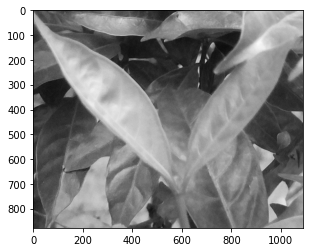

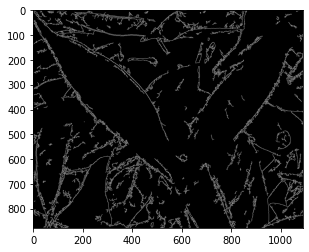

In [ ]:
# Edge Detection Tea
import cv2
import numpy as np
import matplotlib.pyplot as plt

# read the image
image = cv2.imread("IMG_0.jpg")

# convert it to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# show the grayscale image
plt.imshow(gray, cmap="gray")
plt.show()

# perform the canny edge detector to detect image edges
edges = cv2.Canny(gray, threshold1=30, threshold2=100)

plt.imshow(edges, cmap="gray")
plt.show()

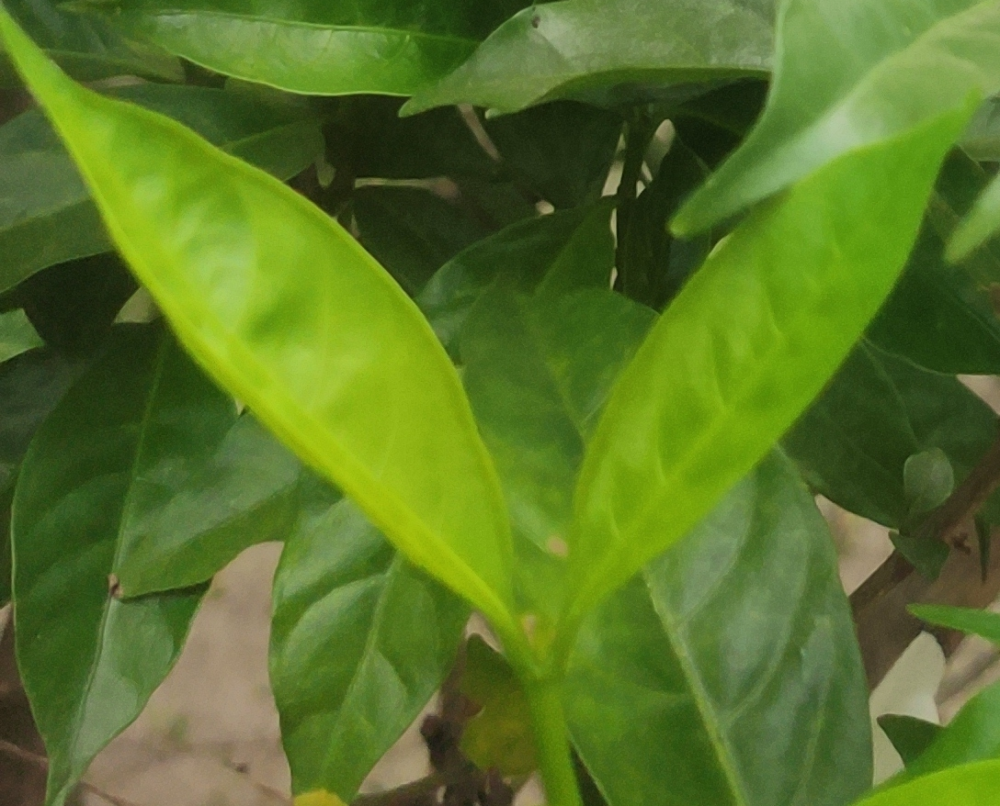

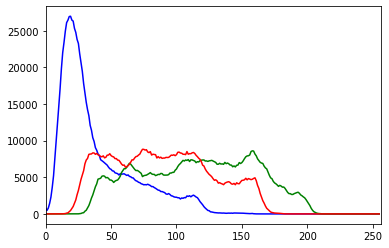

In [ ]:
# We need cv2 module for image
# reading and matplotlib module
# for plotting
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

img_bgr = cv2.imread('IMG_0.jpg', 1)
cv2_imshow(img_bgr)
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_bgr], [i], None, [256], [0, 256])
	plt.plot(histr, color = col)
	plt.xlim([0, 256])
plt.show()

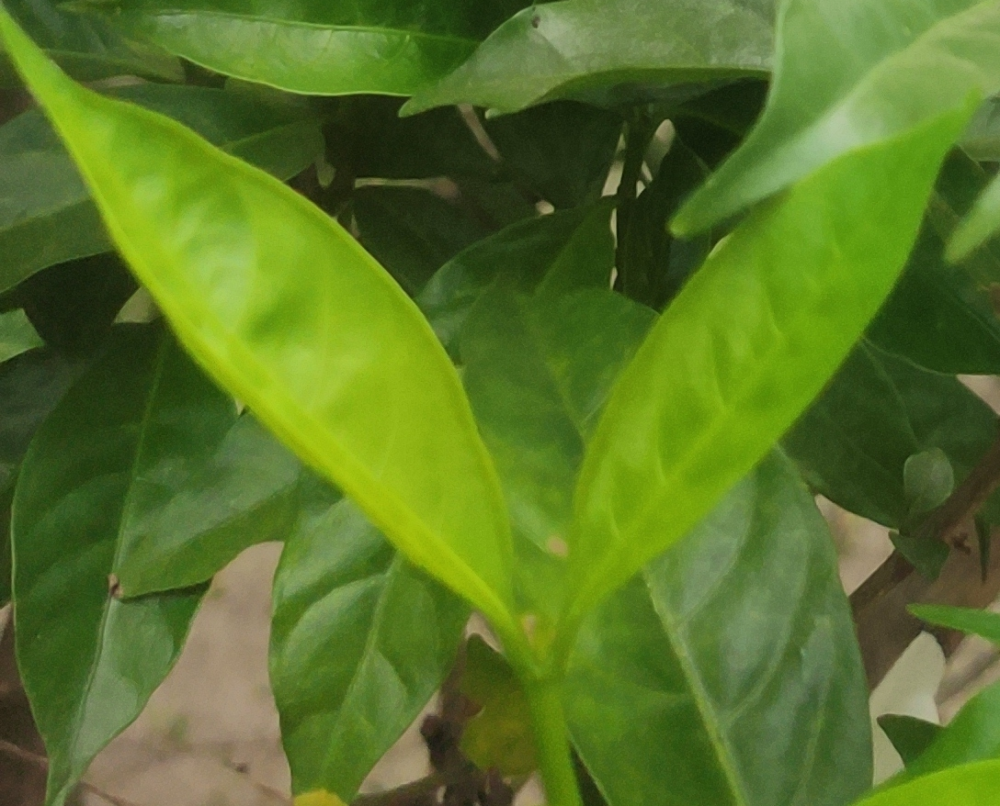

Blue Scale:


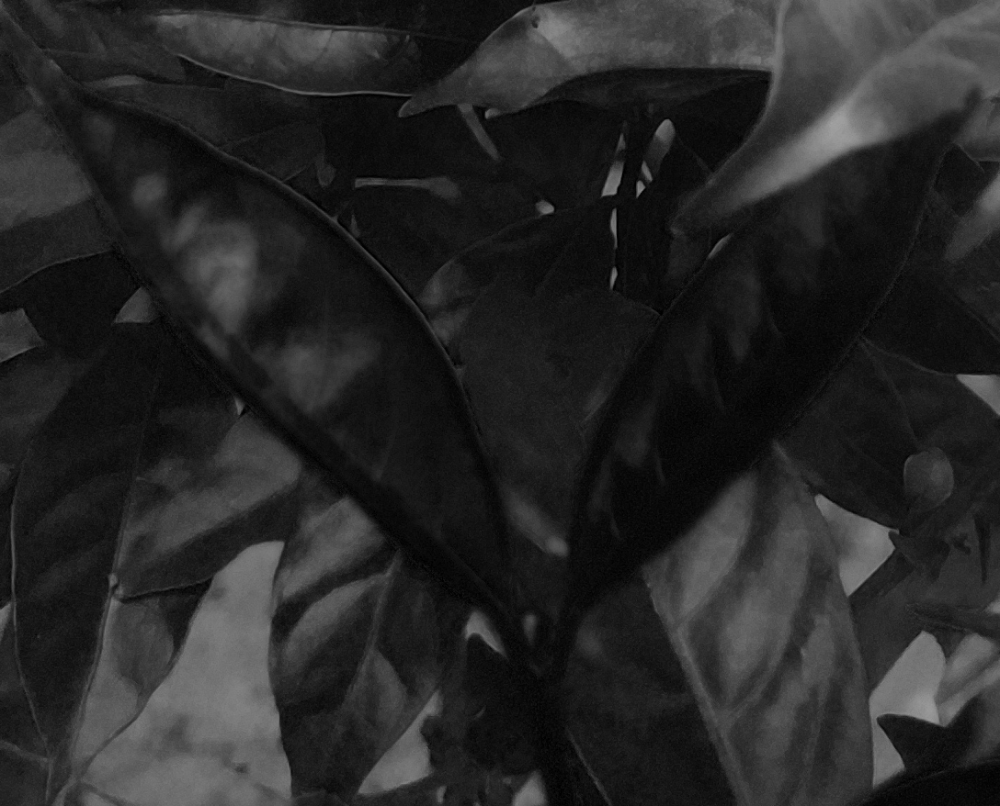

Green Scale:


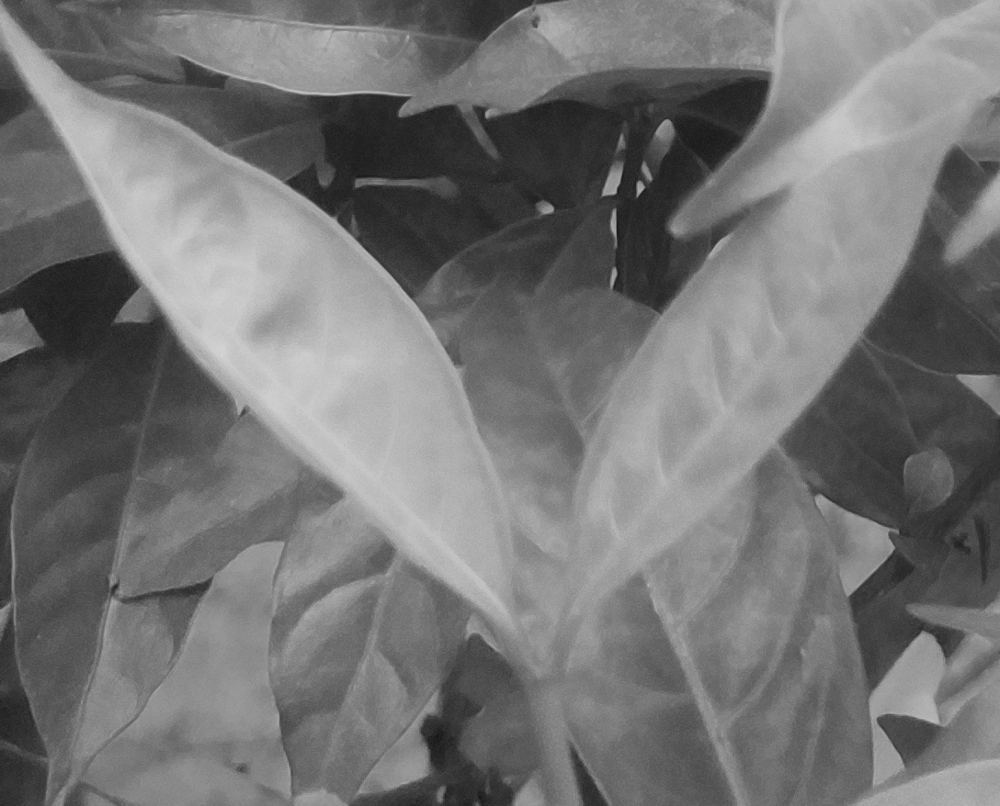

Red Scale:


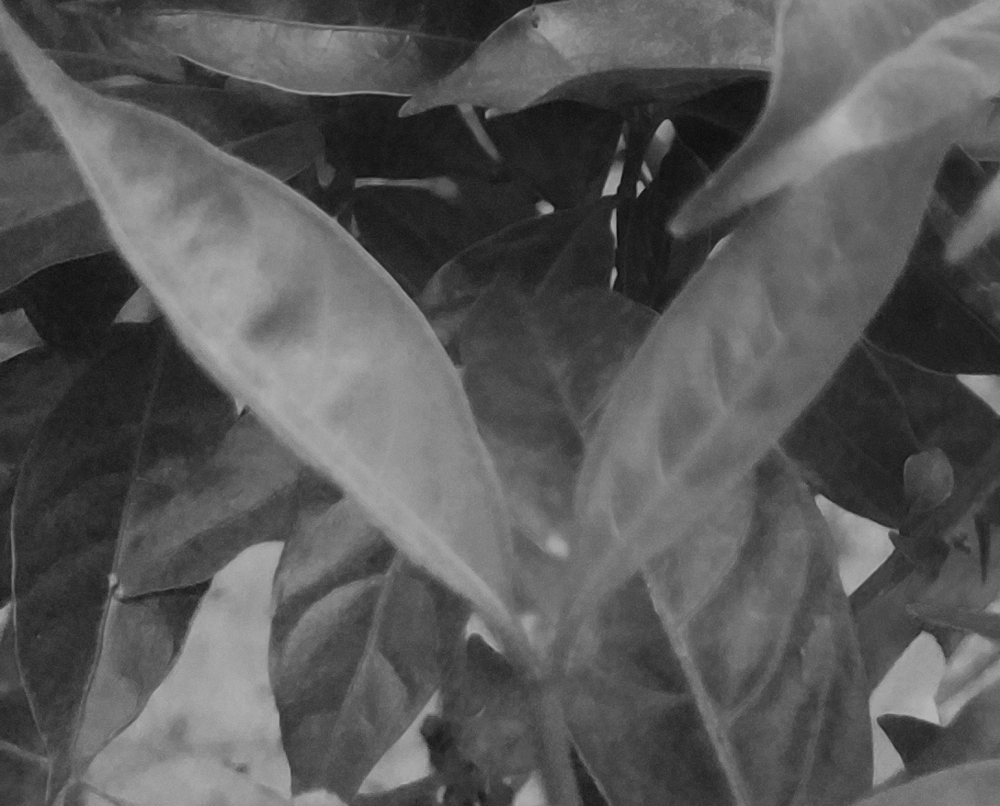

-1

In [ ]:
# Python program to explain splitting of channels

# Importing cv2
import cv2
from google.colab.patches import cv2_imshow

# Reading the image using imread() function
image = cv2.imread('IMG_0.jpg')

# Displaying the original BGR image
cv2_imshow(image)

# Using cv2.split() to split channels of coloured image
b,g,r = cv2.split(image)

# Displaying Blue channel image
# Blue colour is highlighted the most
print("Blue Scale:")
cv2_imshow(b)

# Displaying Green channel image
# Green colour is highlighted the most
print("Green Scale:")
cv2_imshow(g)

# Displaying Red channel image
# Red colour is highlighted the most
print("Red Scale:")
cv2_imshow(r)

# Waits for user to press any key
cv2.waitKey(0)

Backgroung


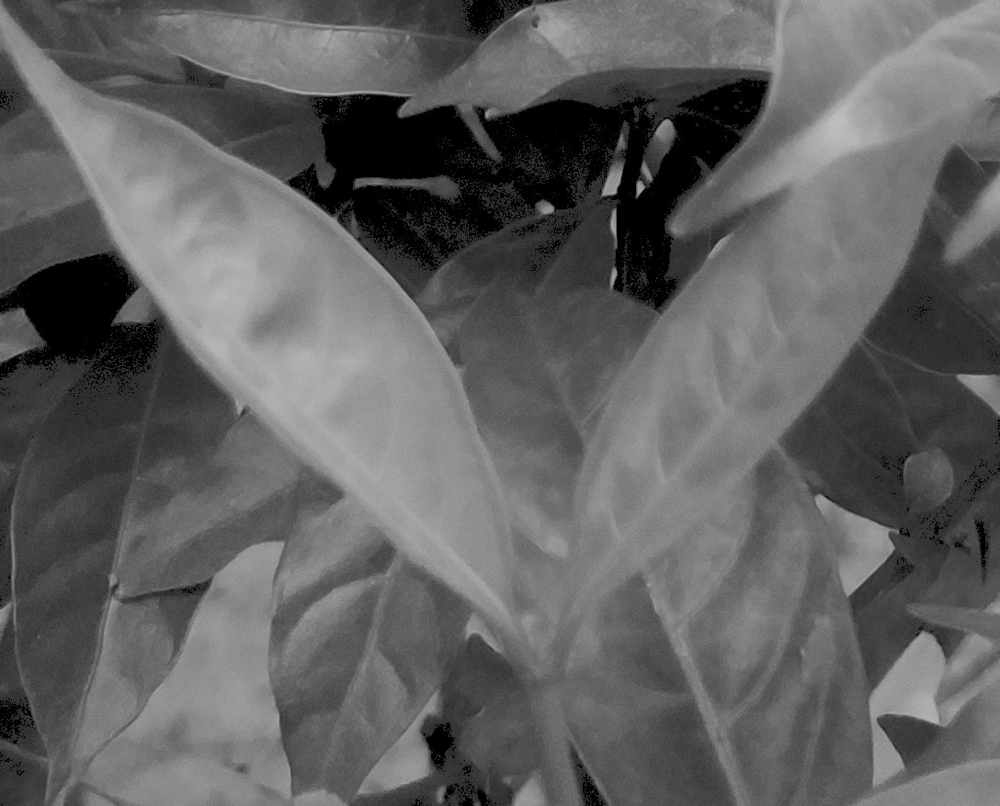

Inverse of Mask


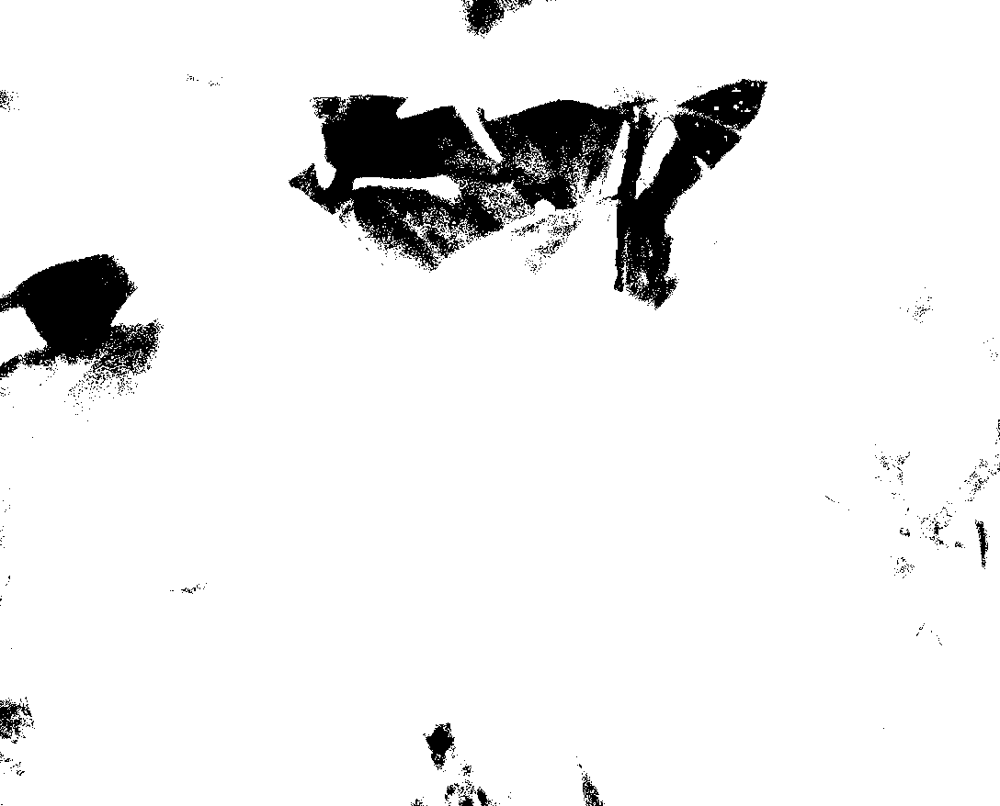

Added Image


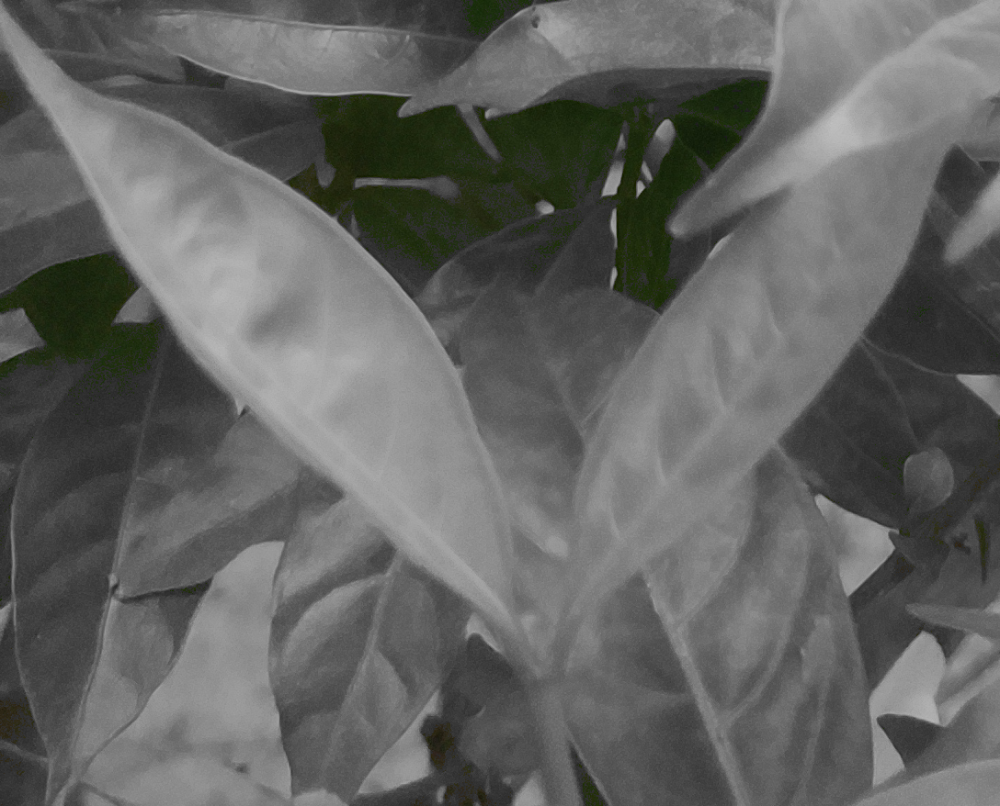

Mask


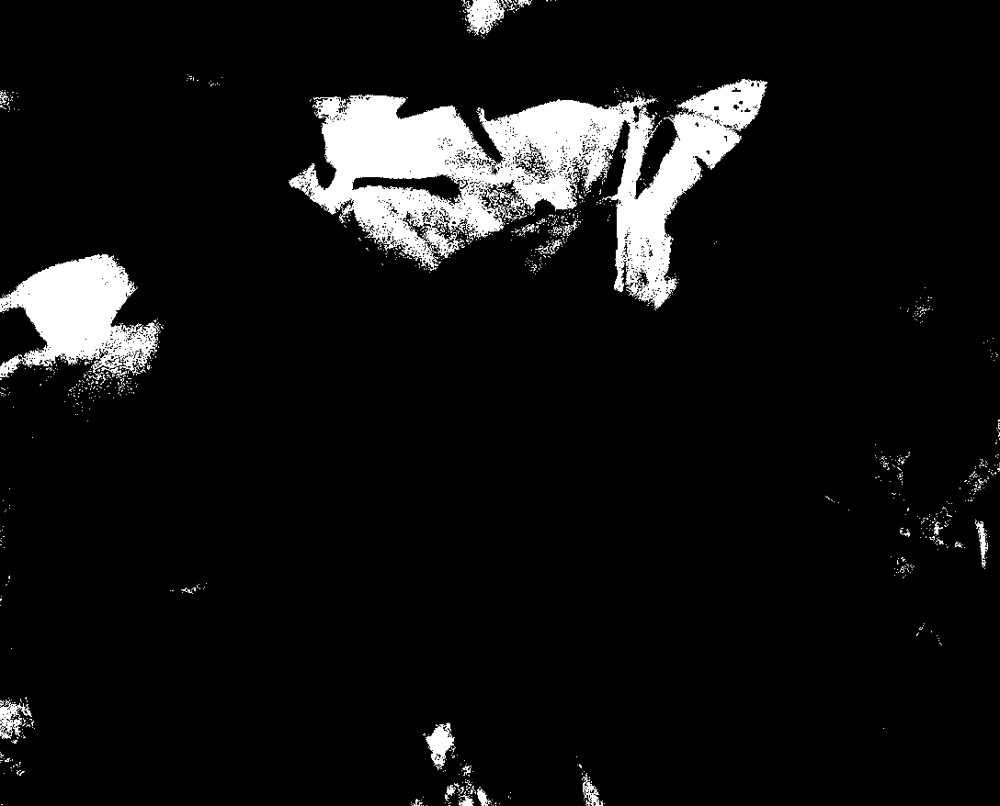

Gray


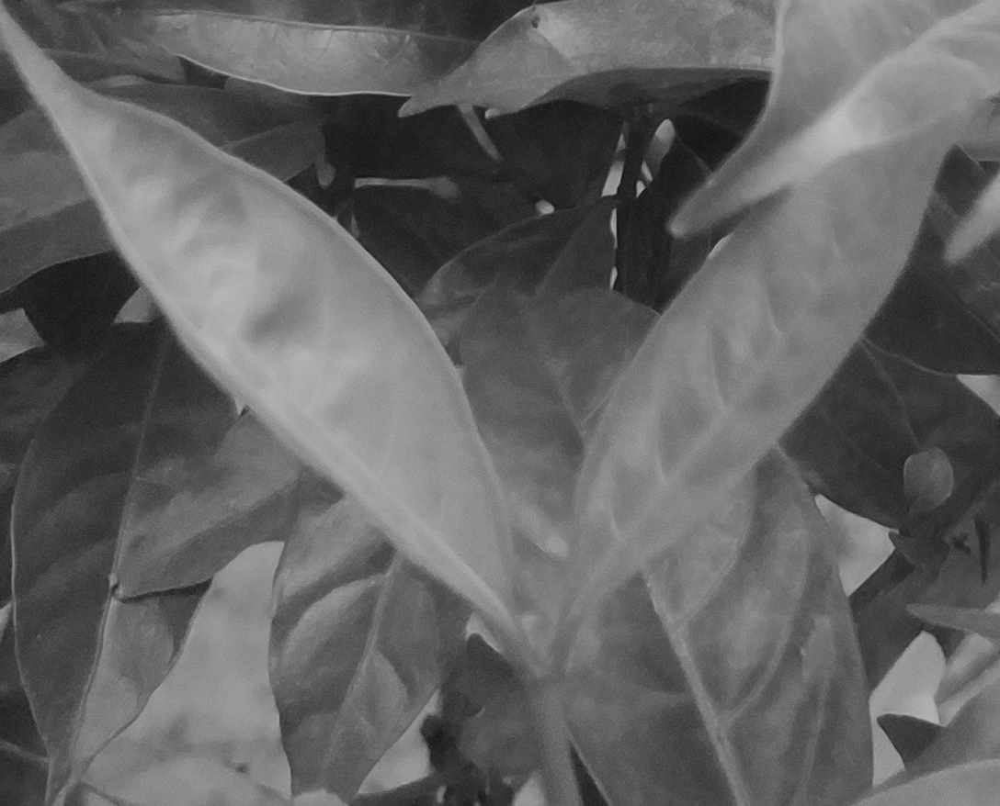

HSV


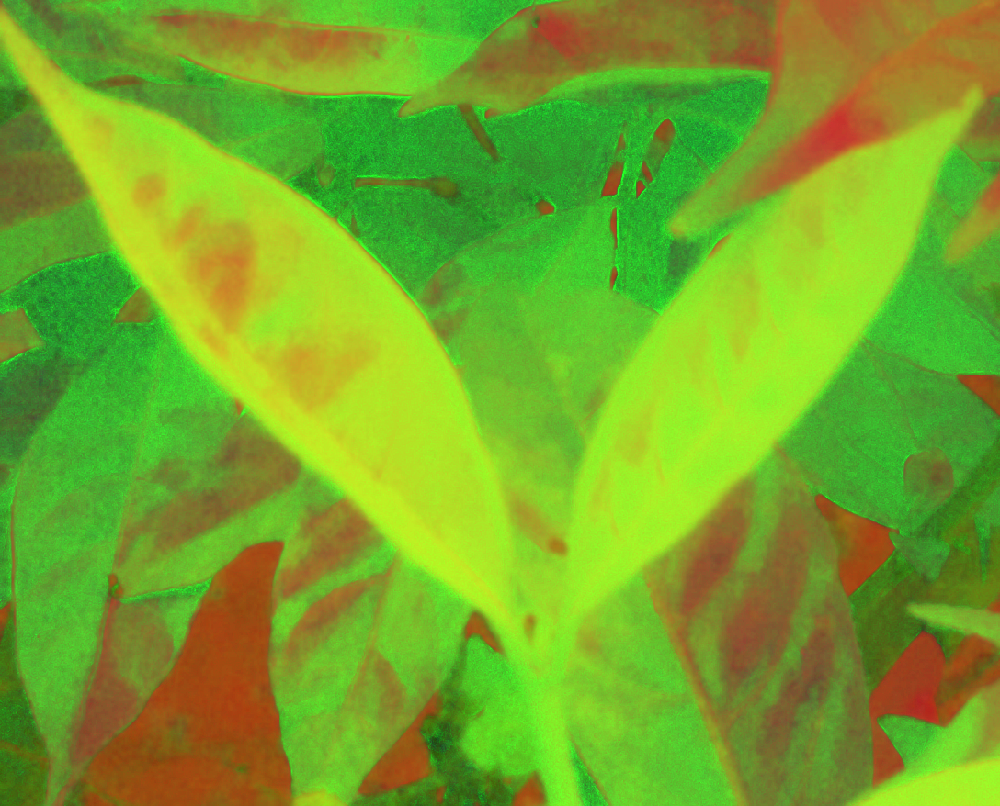

Res


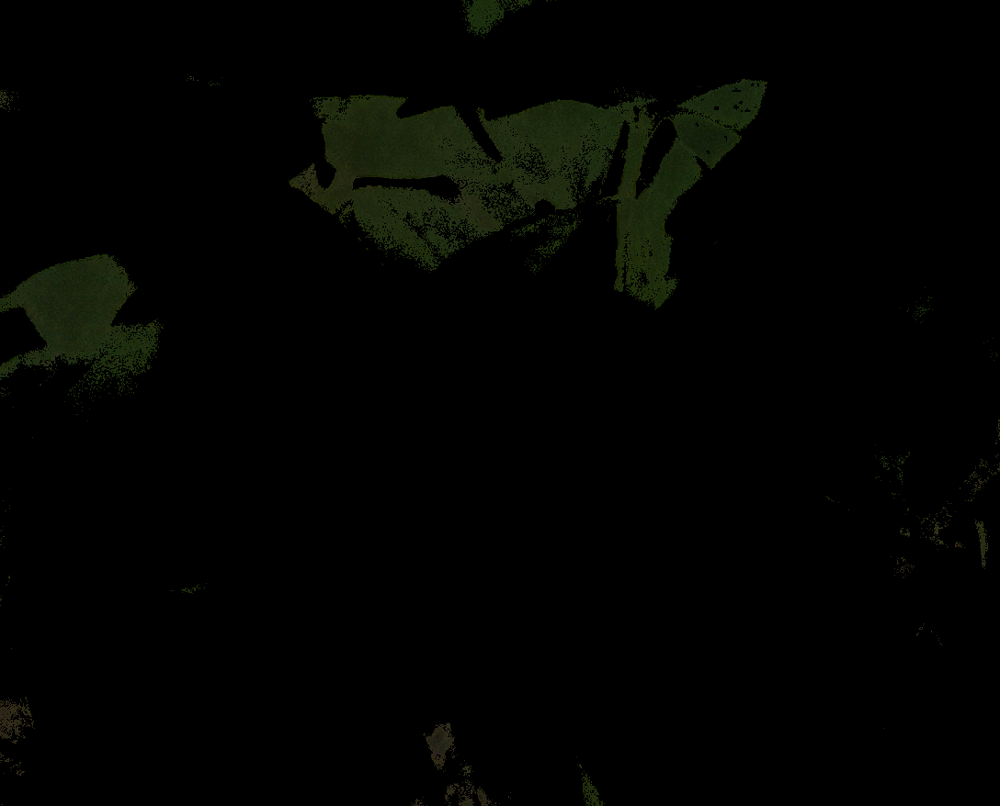

In [ ]:
# Color Filter
#import the libraries
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

#read the image
img = cv.imread("IMG_0.jpg")
#convert the BGR image to HSV colour space
hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
#obtain the grayscale image of the original image
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

#set the bounds for the green hue
lower_green = np.array([0,50,0])
upper_green = np.array([50,255,50])

# create a mask using the bounds set
mask = cv.inRange(hsv, lower_green, upper_green)
# create an inverse of the mask
mask_inv = cv.bitwise_not(mask)
# Filter only the green colour from the original image using the mask(foreground)
res = cv.bitwise_and(img, img, mask=mask)
# Filter the regions containing colours other than green from the grayscale image(background)
background = cv.bitwise_and(gray, gray, mask = mask_inv)
# convert the one channelled grayscale background to a three channelled image
background = np.stack((background,)*3, axis=-1)
# add the foreground and the background
added_img = cv.add(res, background)

#display the images
print("Backgroung")
cv2_imshow(background)
print("Inverse of Mask")
cv2_imshow(mask_inv)
print("Added Image")
cv2_imshow(added_img)
print("Mask")
cv2_imshow(mask)
print("Gray")
cv2_imshow(gray)
print("HSV")
cv2_imshow(hsv)
print("Res")
cv2_imshow(res)

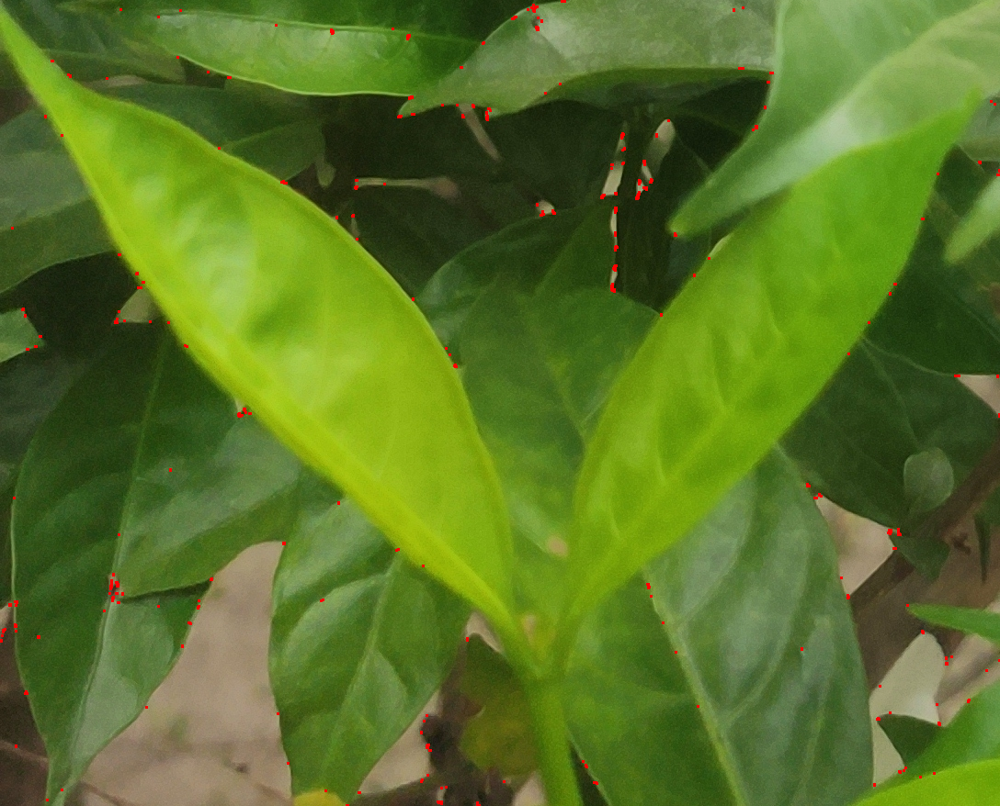

In [ ]:
# Harris Corner Detection

import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

filename = 'IMG_0.jpg'
img = cv.imread(filename)
gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv.cornerHarris(gray,2,3,0.04)
#result is dilated for marking the corners, not important
dst = cv.dilate(dst,None)
# Threshold for an optimal value, it may vary depending on the image.
img[dst>0.01*dst.max()]=[0,0,255]
cv2_imshow(img)
if cv.waitKey(0) & 0xff == 27:
    cv.destroyAllWindows()

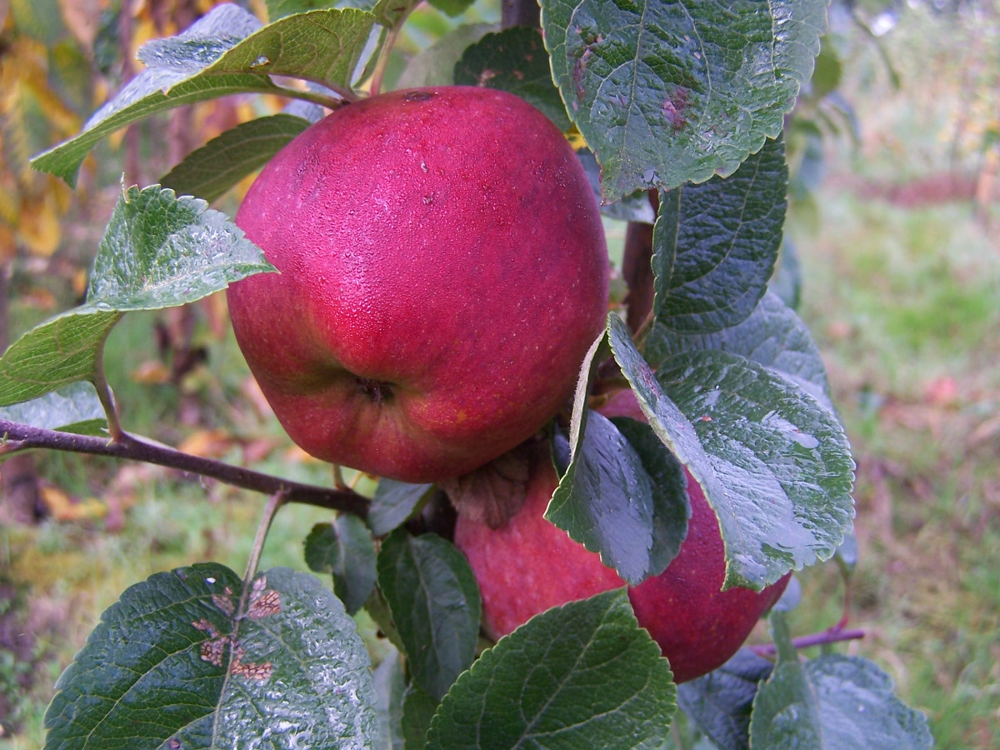

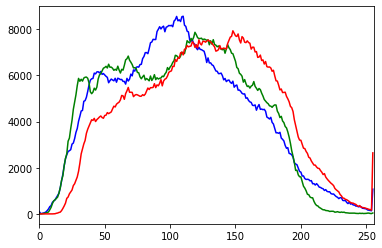

In [ ]:
# We need cv2 module for image
# reading and matplotlib module
# for plotting
import cv2
import matplotlib.pyplot as plt

img_bgr = cv2.imread('000324.jpg', 1)
cv2_imshow(img_bgr)
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_bgr], [i], None, [256], [0, 256])
	plt.plot(histr, color = col)
	plt.xlim([0, 256])
plt.show()

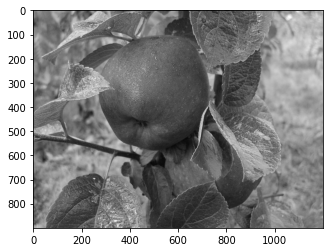

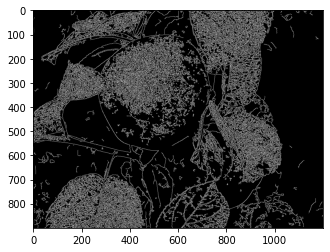

In [ ]:
# Edge Detection
import cv2
import numpy as np
import matplotlib.pyplot as plt

# read the image
image = cv2.imread("000324.jpg")

# convert it to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# show the grayscale image
plt.imshow(gray, cmap="gray")
plt.show()

# perform the canny edge detector to detect image edges
edges = cv2.Canny(gray, threshold1=30, threshold2=100)

plt.imshow(edges, cmap="gray")
plt.show()

Contour detection using blue channels only


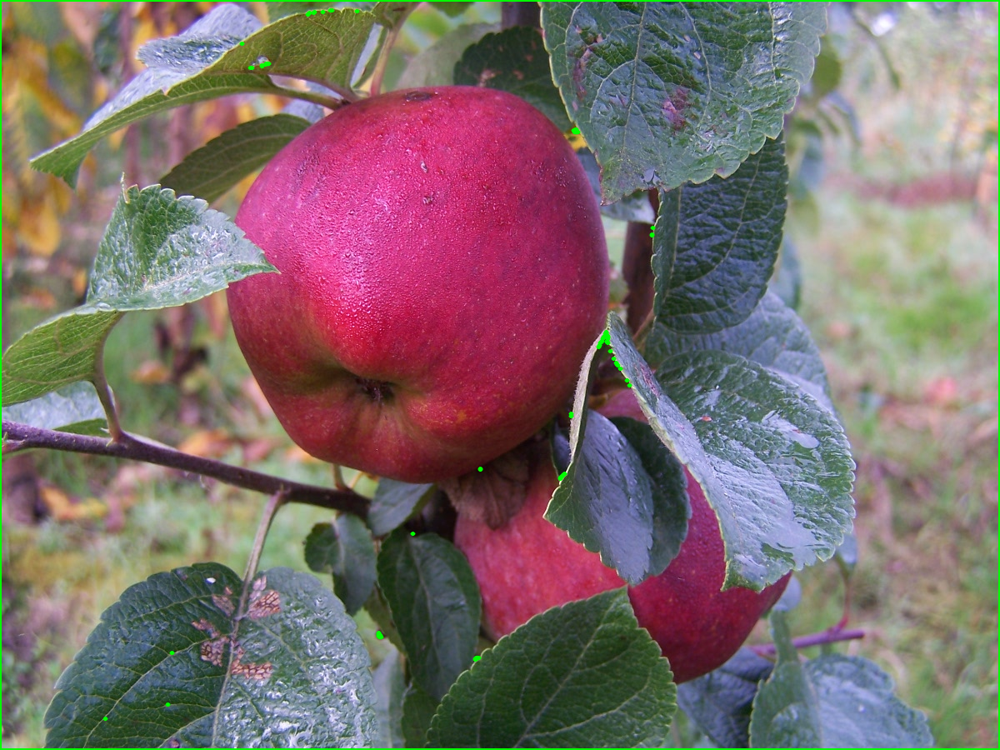

Contour detection using green channels only


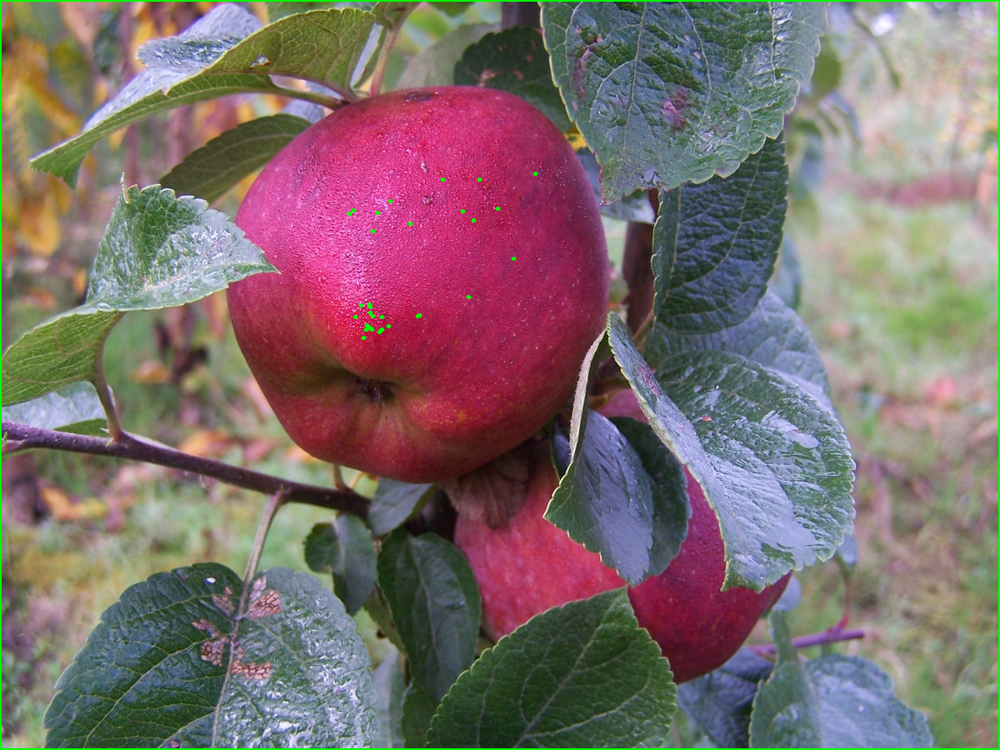

Contour detection using red channels only


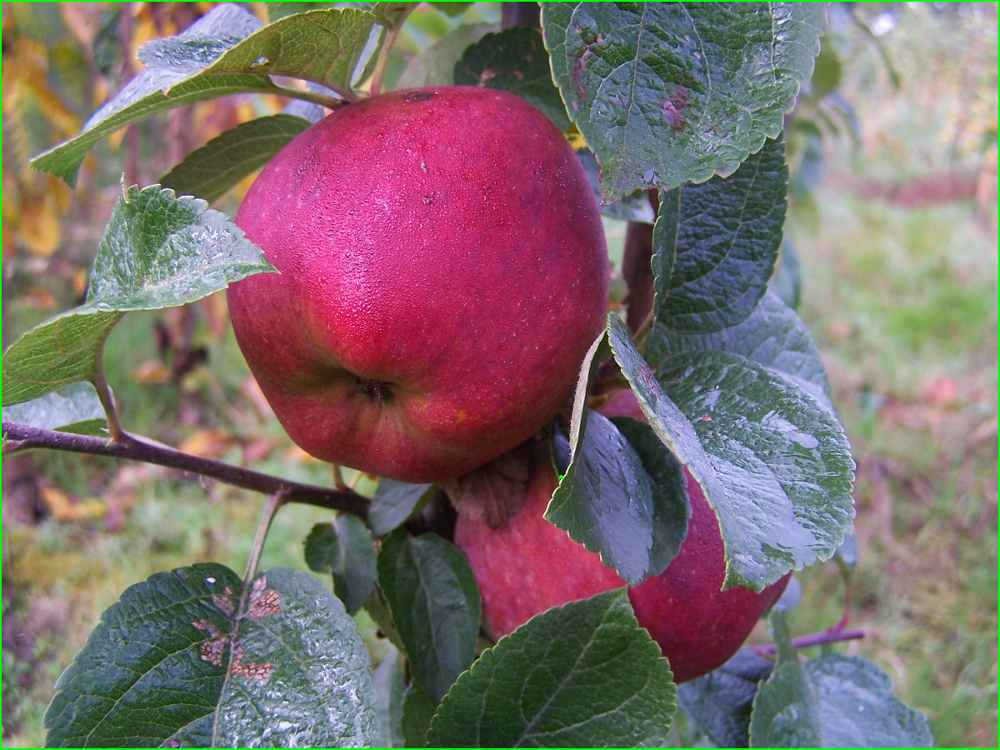

-1

In [ ]:
# Contour Detection

import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

# read the image
image = cv2.imread('000324.jpg')

# B, G, R channel splitting
blue, green, red = cv2.split(image)

# detect contours using blue channel and without thresholding
contours1, hierarchy1 = cv2.findContours(image=blue, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

# draw contours on the original image
image_contour_blue = image.copy()
cv2.drawContours(image=image_contour_blue, contours=contours1, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
print('Contour detection using blue channels only')
cv2_imshow(image_contour_blue)

# detect contours using green channel and without thresholding
contours2, hierarchy2 = cv2.findContours(image=green, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
# draw contours on the original image
image_contour_green = image.copy()
cv2.drawContours(image=image_contour_green, contours=contours2, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
print('Contour detection using green channels only')
cv2_imshow(image_contour_green)
cv2.waitKey(0)

# detect contours using red channel and without thresholding
contours3, hierarchy3 = cv2.findContours(image=red, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
# draw contours on the original image
image_contour_red = image.copy()
cv2.drawContours(image=image_contour_red, contours=contours3, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
# see the results
print('Contour detection using red channels only')
cv2_imshow(image_contour_red)
cv2.waitKey(0)

Backgroung


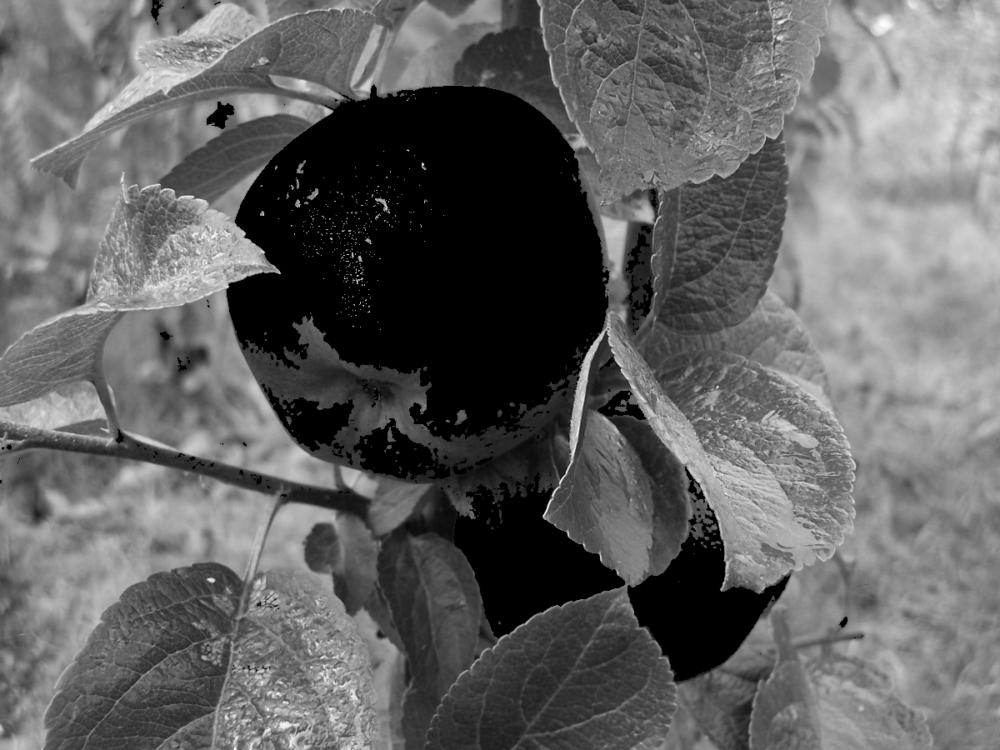

Inverse of Mask


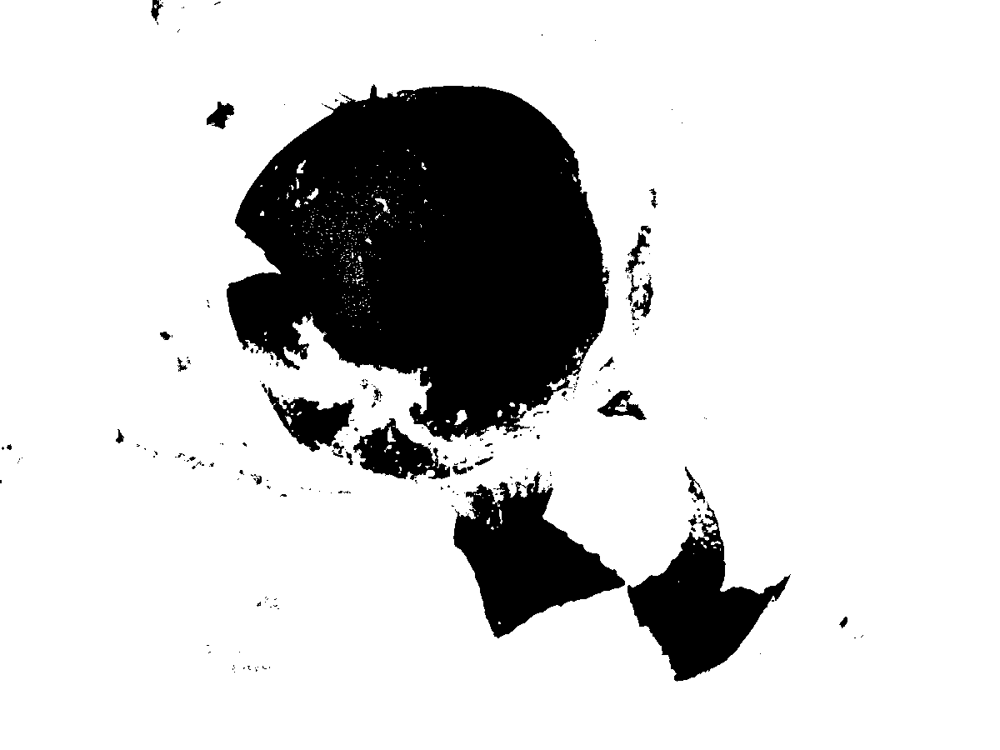

Added Image


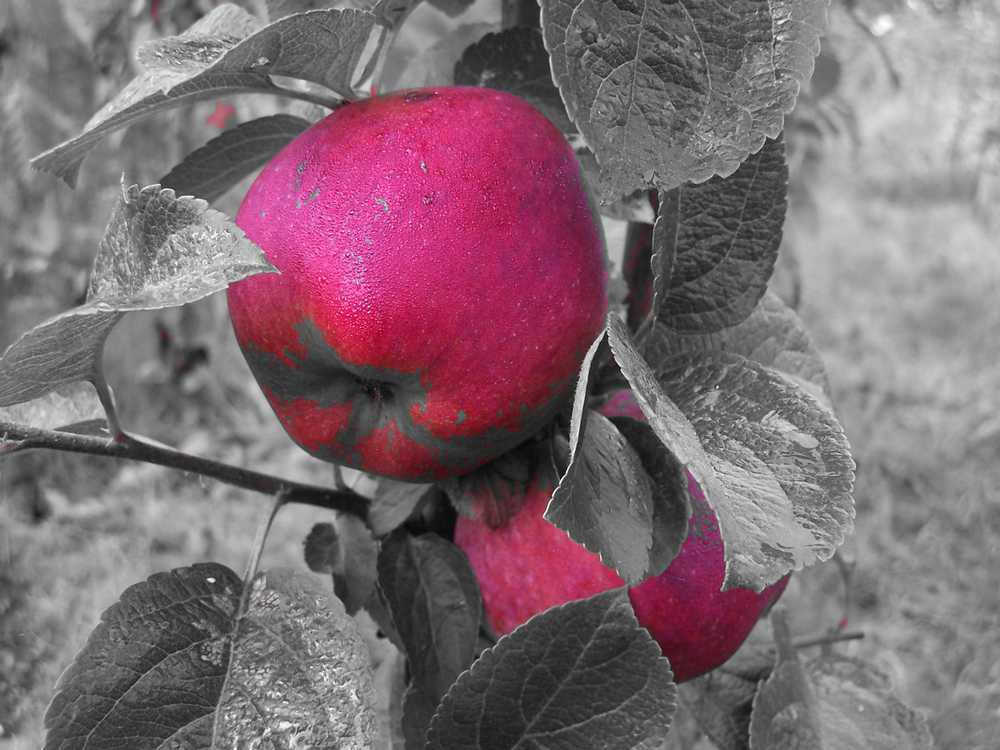

Mask


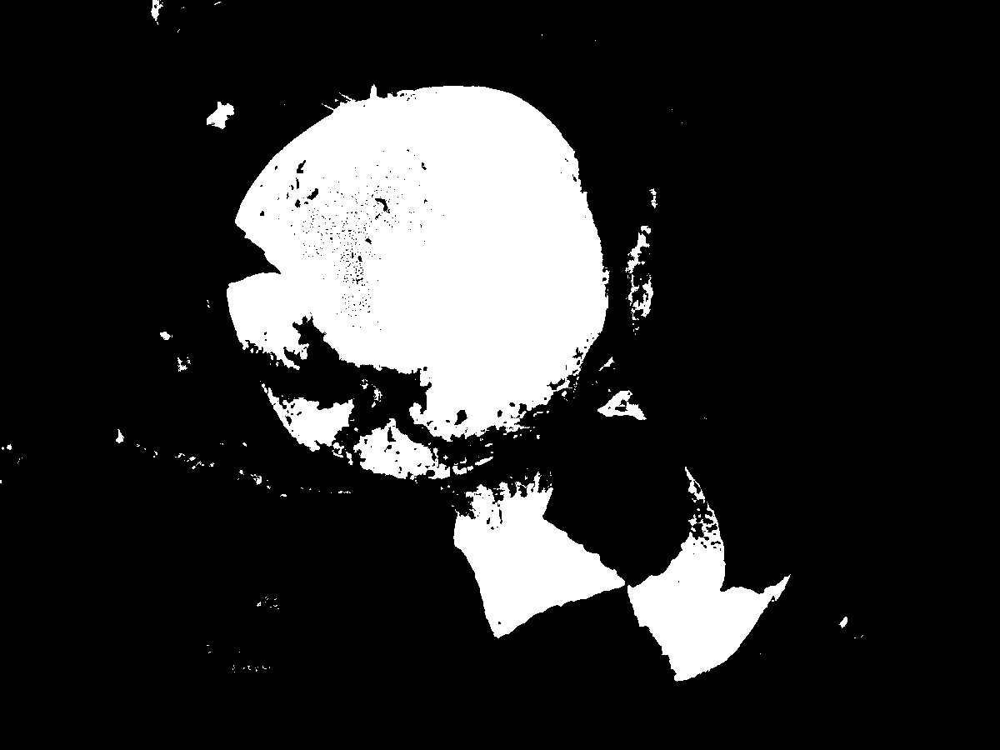

Gray


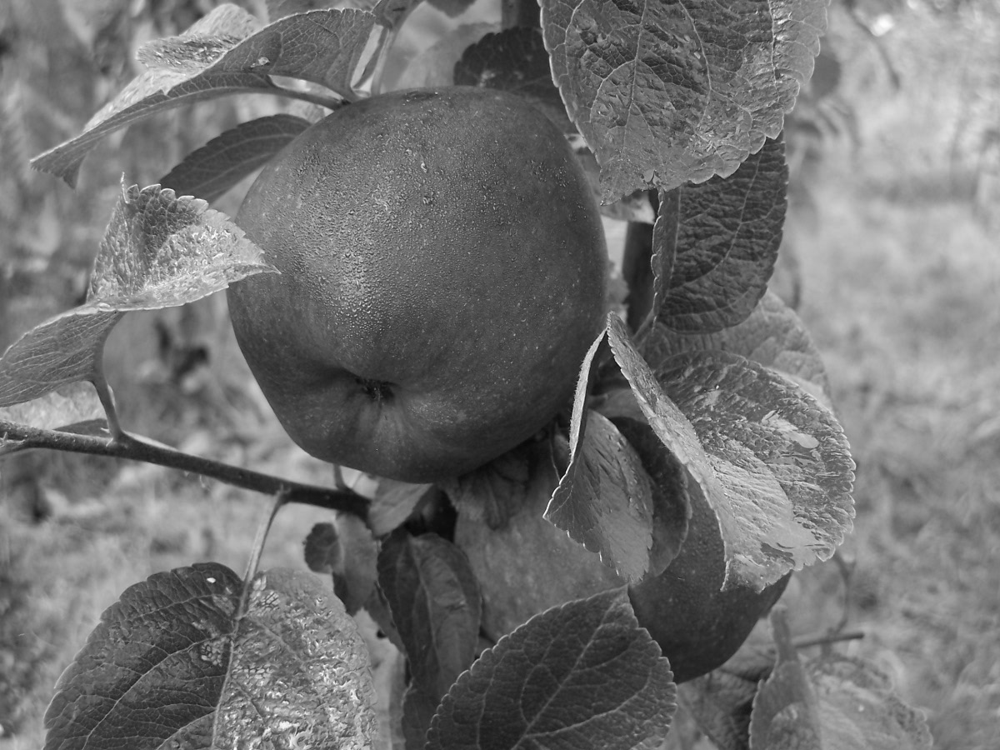

HSV


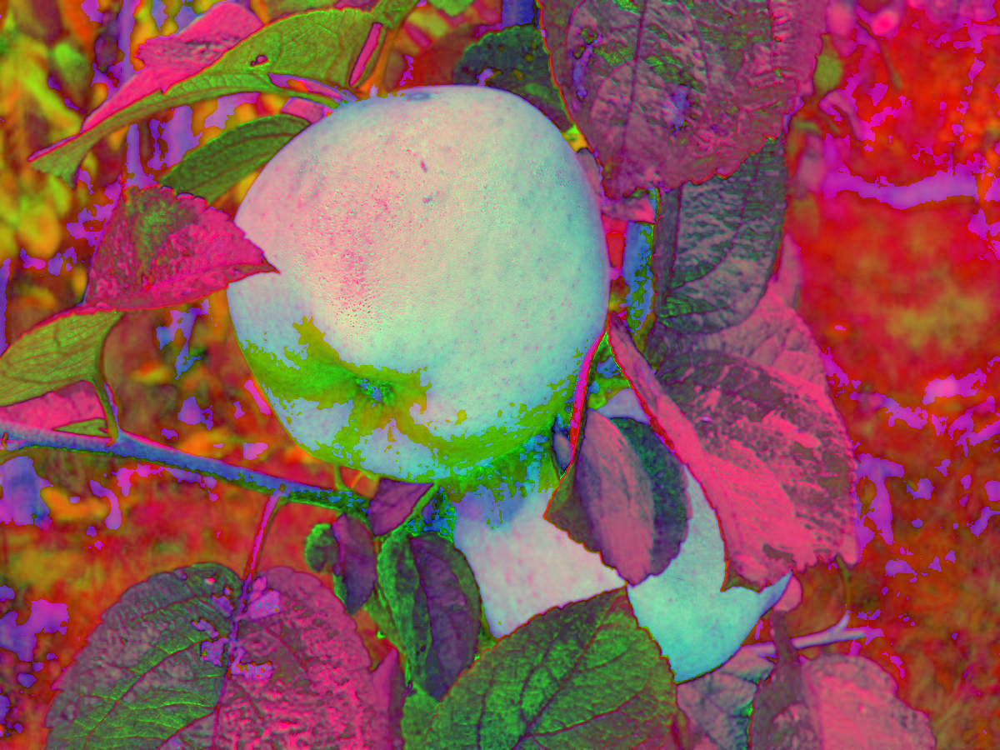

Res


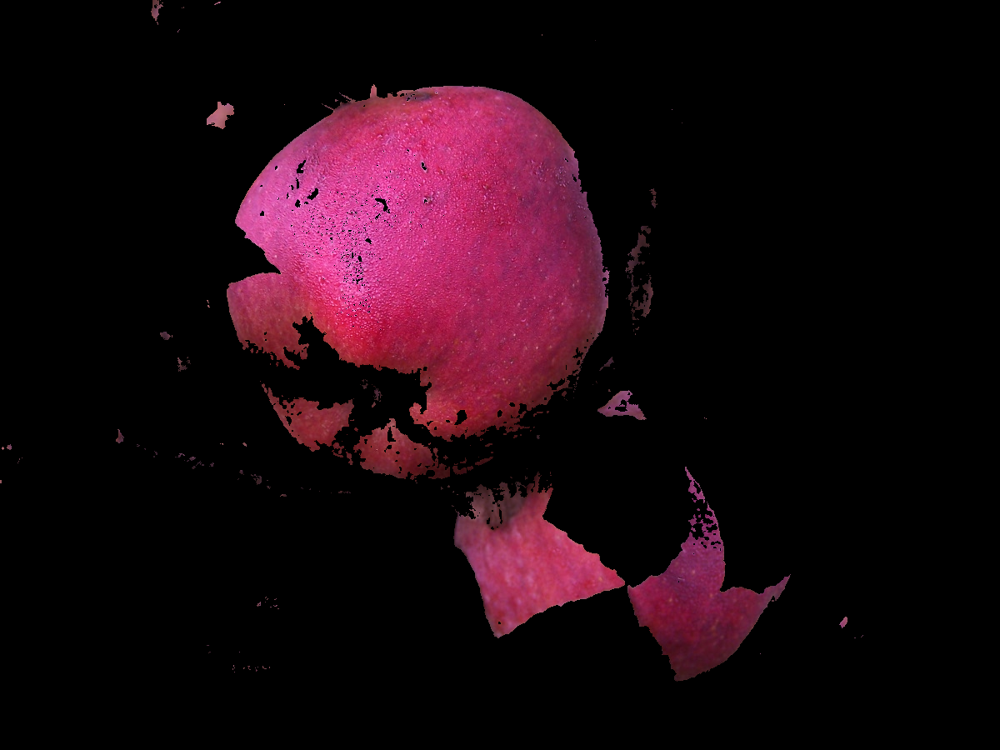

In [ ]:
# Color Filter
#import the libraries
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

#read the image
img = cv.imread("000324.jpg")
#convert the BGR image to HSV colour space
hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
#obtain the grayscale image of the original image
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

#set the bounds for the red hue
lower_red = np.array([160,100,50])
upper_red = np.array([180,255,255])

#create a mask using the bounds set
mask = cv.inRange(hsv, lower_red, upper_red)
#create an inverse of the mask
mask_inv = cv.bitwise_not(mask)
#Filter only the red colour from the original image using the mask(foreground)
res = cv.bitwise_and(img, img, mask=mask)
#Filter the regions containing colours other than red from the grayscale image(background)
background = cv.bitwise_and(gray, gray, mask = mask_inv)
#convert the one channelled grayscale background to a three channelled image
background = np.stack((background,)*3, axis=-1)
#add the foreground and the background
added_img = cv.add(res, background)

#display the images
print("Backgroung")
cv2_imshow(background)
print("Inverse of Mask")
cv2_imshow(mask_inv)
print("Added Image")
cv2_imshow(added_img)
print("Mask")
cv2_imshow(mask)
print("Gray")
cv2_imshow(gray)
print("HSV")
cv2_imshow(hsv)
print("Res")
cv2_imshow(res)

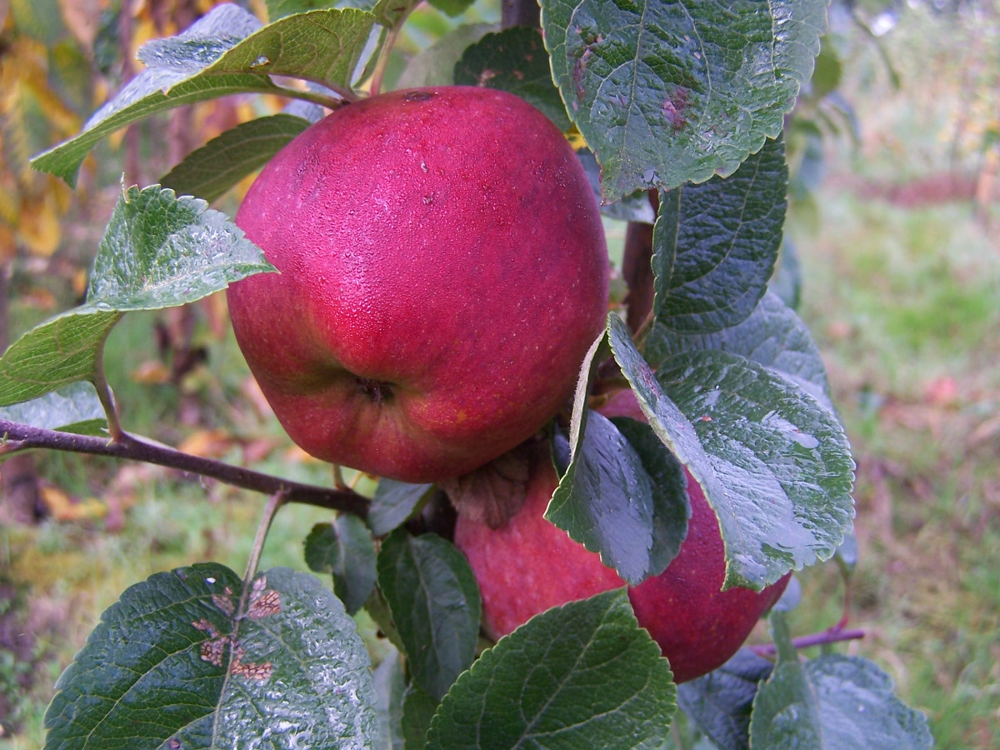

Blue Scale:


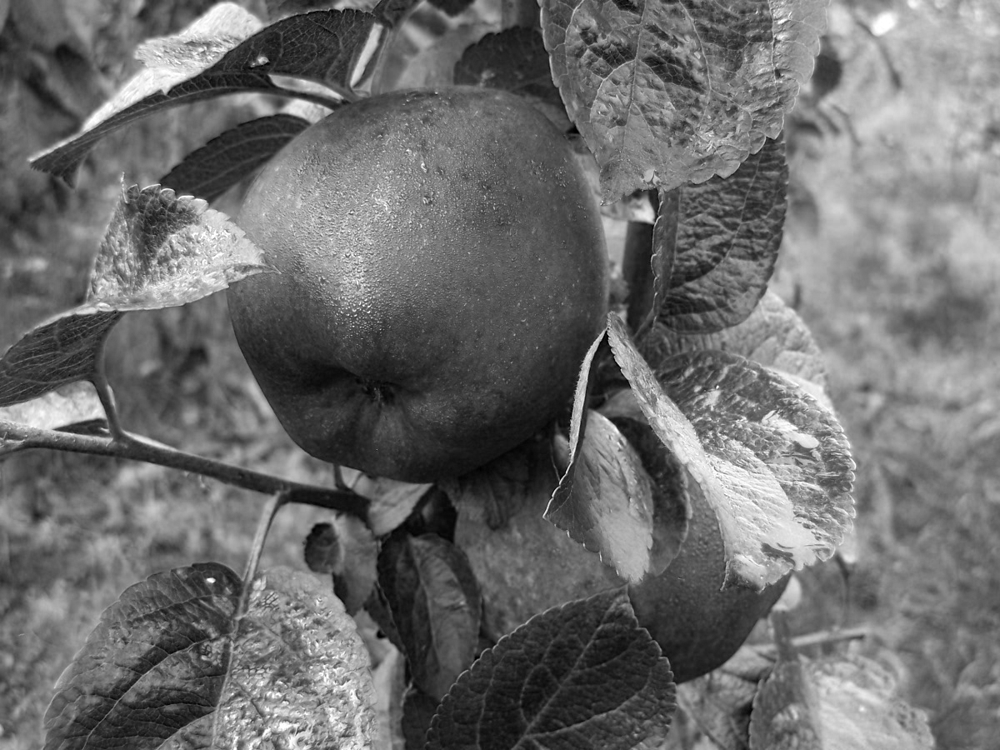

Green Scale:


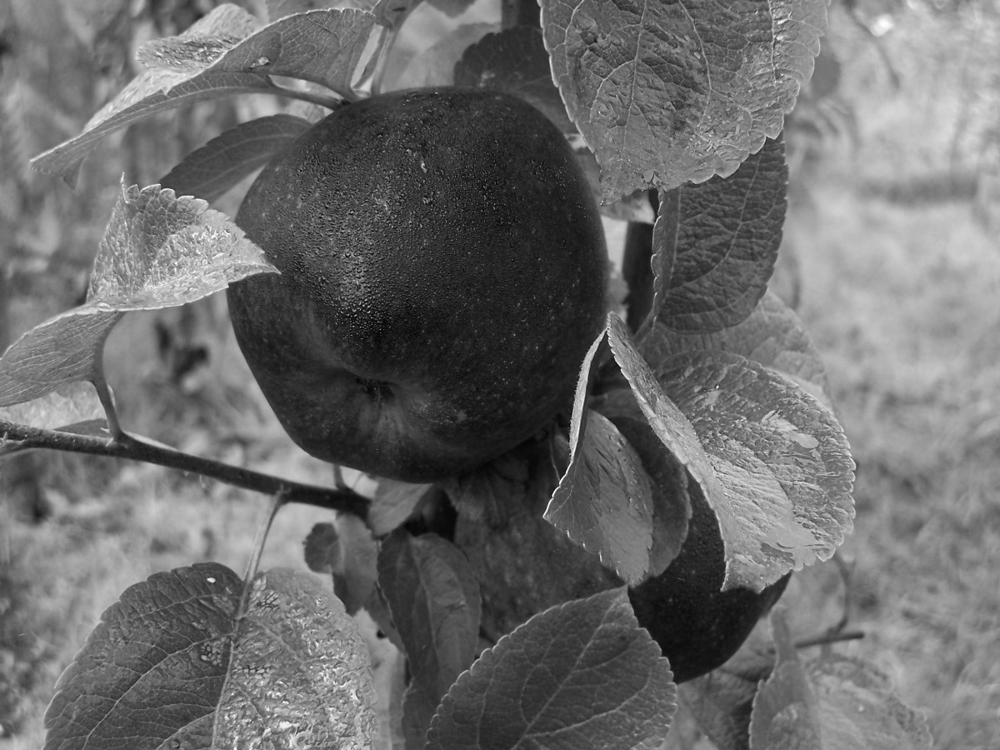

Red Scale:


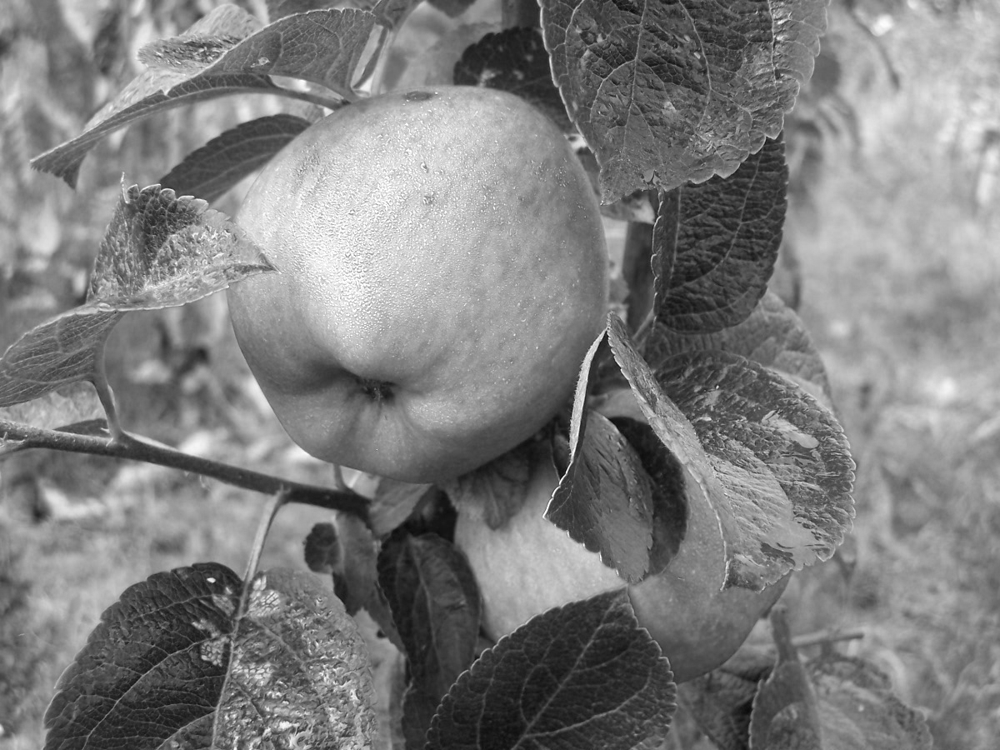

-1

In [ ]:
# Python program to explain splitting of channels

# Importing cv2
import cv2
from google.colab.patches import cv2_imshow

# Reading the image using imread() function
image = cv2.imread('000324.jpg')

# Displaying the original BGR image
cv2_imshow(image)

# Using cv2.split() to split channels of coloured image
b,g,r = cv2.split(image)

# Displaying Blue channel image
# Blue colour is highlighted the most
print("Blue Scale:")
cv2_imshow(b)

# Displaying Green channel image
# Green colour is highlighted the most
print("Green Scale:")
cv2_imshow(g)

# Displaying Red channel image
# Red colour is highlighted the most
print("Red Scale:")
cv2_imshow(r)

# Waits for user to press any key
cv2.waitKey(0)

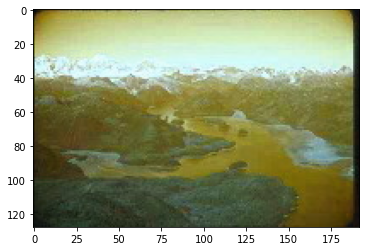

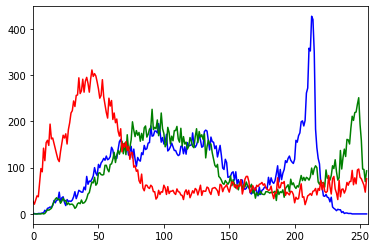

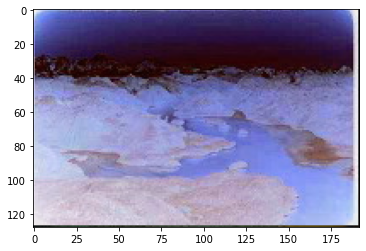

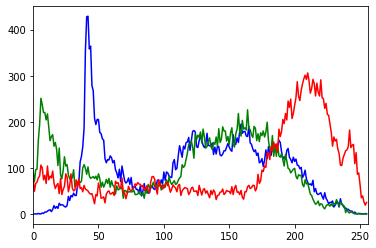

In [ ]:
# Convert Negative
import cv2
import matplotlib.pyplot as plt


# Read an image
img_bgr = cv2.imread('scenary.jpg', 1)
plt.imshow(img_bgr)
plt.show()
# Histogram plotting of the image
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_bgr],
						[i], None,
						[256],
						[0, 256])
	plt.plot(histr, color = col)
	# Limit X - axis to 256
	plt.xlim([0, 256])
plt.show()
# get height and width of the image
height, width, _ = img_bgr.shape
for i in range(0, height - 1):
	for j in range(0, width - 1):
		# Get the pixel value
		pixel = img_bgr[i, j]
		# Negate each channel by
		# subtracting it from 255
		# 1st index contains red pixel
		pixel[0] = 255 - pixel[0]
		# 2nd index contains green pixel
		pixel[1] = 255 - pixel[1]
		# 3rd index contains blue pixel
		pixel[2] = 255 - pixel[2]
		# Store new values in the pixel
		img_bgr[i, j] = pixel
# Display the negative transformed image
plt.imshow(img_bgr)
plt.show()
# Histogram plotting of the
# negative transformed image
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_bgr],
						[i], None,
						[256],
						[0, 256])
	plt.plot(histr, color = col)
	plt.xlim([0, 256])
plt.show()

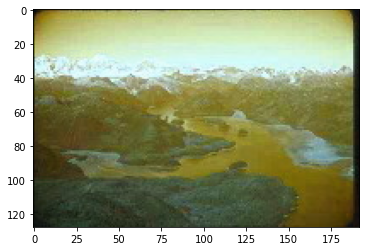

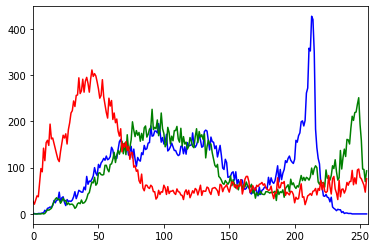

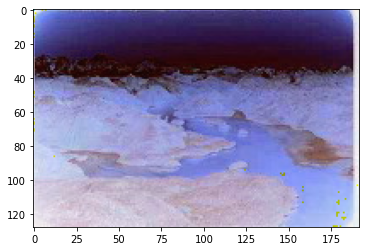

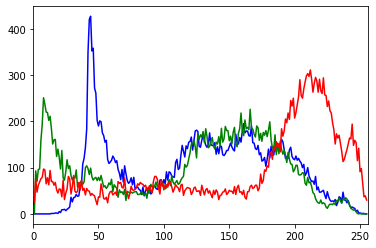

In [ ]:
# Convert Negative 2
import cv2
import matplotlib.pyplot as plt


# Read an image
img_bgr = cv2.imread('scenary.jpg', 1)
plt.imshow(img_bgr)
plt.show()
# Histogram plotting of original image
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_bgr],
						[i], None,
						[256],
						[0, 256])
	plt.plot(histr, color = col)
	# Limit X - axis to 256
	plt.xlim([0, 256])
plt.show()
# Negate the original image
img_neg = 1 - img_bgr
plt.imshow(img_neg)
plt.show()
# Histogram plotting of
# negative transformed image
color = ('b', 'g', 'r')
for i, col in enumerate(color):
	histr = cv2.calcHist([img_neg],
						[i], None,
						[256],
						[0, 256])
	plt.plot(histr, color = col)
	plt.xlim([0, 256])
plt.show()

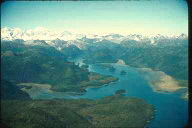

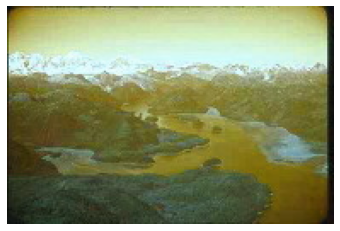

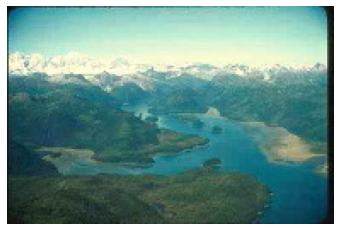

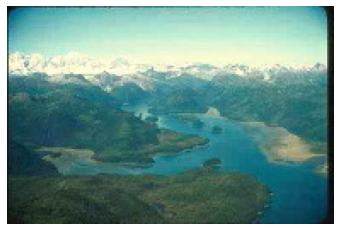

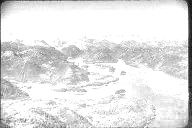

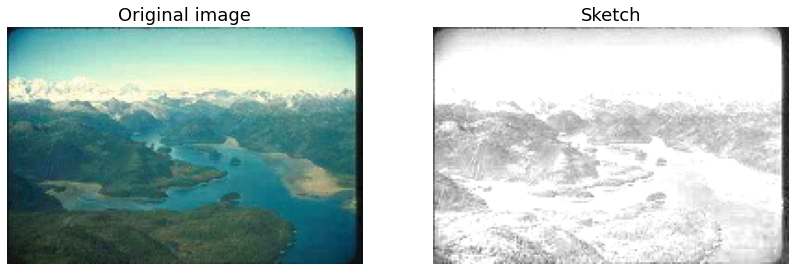

In [ ]:
# Convert Sketch
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

img=cv2.imread("scenary.jpg")
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

plt.imshow(img)
plt.axis(False)
plt.show()

plt.imshow(img[:,:,::-1])
plt.axis(False)
plt.show()

RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(RGB_img)
plt.axis(False)
plt.show()

grey_img=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

invert_img=cv2.bitwise_not(grey_img)
#invert_img=255-grey_img
blur_img=cv2.GaussianBlur(invert_img, (111,111),0)

invblur_img=cv2.bitwise_not(blur_img)
#invblur_img=255-blur_img

sketch_img=cv2.divide(grey_img,invblur_img, scale=256.0)

cv2.imwrite('sketch.png', sketch_img)

cv2_imshow(sketch_img)
cv2.waitKey(0)
cv2.destroyAllWindows()

plt.figure(figsize=(14,8))
plt.subplot(1,2,1)
plt.title('Original image', size=18)
plt.imshow(RGB_img)
plt.axis('off')
plt.subplot(1,2,2)
plt.title('Sketch', size=18)
rgb_sketch=cv2.cvtColor(sketch_img, cv2.COLOR_BGR2RGB)
plt.imshow(rgb_sketch)
plt.axis('off')
plt.show()

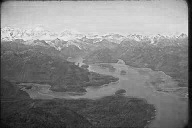

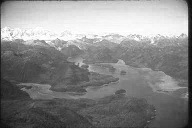

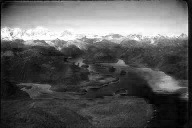

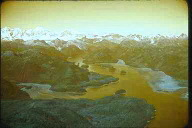

-1

In [ ]:
# Split and Merge Image

# Python program to explain Merging of Channels

# Importing cv2
import cv2
from google.colab.patches import cv2_imshow

# Reading the BGR image using imread() function
image = cv2.imread("scenary.jpg")

# Splitting the channels first to generate different
# single

# channels for merging as we don't have separate
# channel images
b, g, r = cv2.split(image)

# Displaying Blue channel image
cv2_imshow(b)

# Displaying Green channel image
cv2_imshow(g)

# Displaying Red channel image
cv2_imshow(r)

# Using cv2.merge() to merge Red, Green, Blue Channels

# into a coloured/multi-channeled image
image_merge = cv2.merge([r, g, b])

# Displaying Merged RGB image
cv2_imshow(image_merge)

# Waits for user to press any key
cv2.waitKey(0)

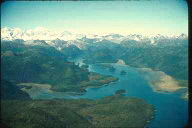

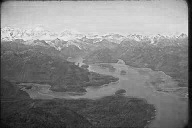

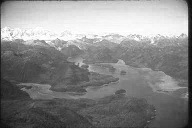

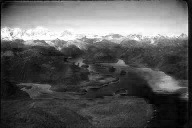

-1

In [ ]:
# Split Image

# Python program to explain splitting of channels

# Importing cv2
import cv2
from google.colab.patches import cv2_imshow

# Reading the image using imread() function
image = cv2.imread('scenary.jpg')

# Displaying the original BGR image
cv2_imshow(image)

# Using cv2.split() to split channels of coloured image
b,g,r = cv2.split(image)

# Displaying Blue channel image
# Blue colour is highlighted the most
cv2_imshow(b)

# Displaying Green channel image
# Green colour is highlighted the most
cv2_imshow(g)

# Displaying Red channel image
# Red colour is highlighted the most
cv2_imshow(r)

# Waits for user to press any key
cv2.waitKey(0)

In [ ]:
import cv2
import numpy as np
import math
from google.colab.patches import cv2_imshow

whT = 320
hT = 320
confThreshold = 0.5
nmsThreshold = 0.3

classesFile = "coco.names"
classNames = []
with open(classesFile,"rt") as f:
    classNames = f.read().rstrip('\n').split('\n')
#print(classNames)
#print(len(classNames))

modelConfiguration = 'yolov4.cfg'
modelWeights = 'yolov4.weights'

net = cv2.dnn.readNetFromDarknet(modelConfiguration,modelWeights)
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

def findObjects(ouputs,img):
    hT, wT, cT = img.shape
    bbox = []
    classIds = []
    confs = []
    for output in outputs:
        for det in output:
            scores = det[5:]
            classId = np.argmax(scores)
            confidence = scores[classId]
            if confidence > confThreshold:
                w,h = int(det[2]*wT), int(det[3]*hT)
                x,y = int((det[0]*wT) - w/2), int((det[1]*hT)-h/2)
                bbox.append([x,y,w,h])
                classIds.append(classId)
                confs.append(float(confidence))
    indices = cv2.dnn.NMSBoxes(bbox,confs,confThreshold,nmsThreshold)
    #print(indices)
    for i in indices:
        box = bbox[i]
        x,y,w,h = box[0],box[1],box[2],box[3]
        if classNames[classIds[i]] == 'apple':
            d = (((x+w)-x)**2 + ((y+h)-y)**2)
            distance = math.sqrt(d)
            c = ((((x+w)+x)//2), ((y+h)+y)//2)
            cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,255),2)
            cv2.putText(img,f'{classNames[classIds[i]]} {int(confs[i]*100)}% {(x,y)} {(x+w,y+h)} Center:{c}',(x,y-10),cv2.FONT_HERSHEY_SIMPLEX,0.6,(255,0,255),2)


img = cv2.imread("000515.jpg")

blob = cv2.dnn.blobFromImage(img,1/255,(whT,hT),[0,0,0],1,crop=False)
net.setInput(blob)

layerNames = net.getLayerNames()
#print(layerNames)
#print(len(layerNames))
#print(net.getUnconnectedOutLayers())
outputNames = [layerNames[i-1] for i in net.getUnconnectedOutLayers()]
#print(outputNames)
outputs = net.forward(outputNames)
#print(len(outputs))
#print(type(outputs))
#print(outputs[0])
#print(outputs[0].shape)
#print(outputs[1].shape)
#print(outputs[2].shape)
#print(outputs[0][0])
findObjects(outputs, img)
cv2_imshow(img)
cv2.waitKey(0)

error: ignored

In [ ]:
# Color Space Change
import cv2 as cv
import numpy as np
cap = cv.VideoCapture(0)
while(1):
    # Take each frame
    _, frame = cap.read()
    # Convert BGR to HSV
    hsv = cv.cvtColor(frame, cv.COLOR_BGR2HSV)
    # define range of blue color in HSV
    lower_blue = np.array([110,50,50])
    upper_blue = np.array([130,255,255])
    # Threshold the HSV image to get only blue colors
    mask = cv.inRange(hsv, lower_blue, upper_blue)
    # Bitwise-AND mask and original image
    res = cv.bitwise_and(frame,frame, mask= mask)
    cv.imshow('frame',frame)
    cv.imshow('mask',mask)
    cv.imshow('res',res)
    k = cv.waitKey(5) & 0xFF
    if k == 27:
        break
cv.destroyAllWindows()

error: ignored

In [ ]:
# Live Feed
import numpy as np
import cv2

cap = cv2.VideoCapture(0)

while True:
    _, frame = cap.read()
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 30, 100)
    cv2_imshow(edges)
    cv2_imshow(gray)
    if cv2.waitKey(1) == ord("q"):
        break

cap.release()
cv2.destroyAllWindows()

error: ignored